# Understanding Forgetting in Neural Networks with One Neuron

In the past few years a number of papers have shown the impact of forgetting in neural networks when learning continually over time and without access to previously encountered data. However, many of the examples used to describe the phenomenon are quite complex and involve thousands if not million of parameters.

In this brief notebook I'll try to make the simplest possible example of catastrophic forgetting in neural networks, with just **one neuron** and **two paramerers** (a weight and a bias term), i.e. using a linear regression.

We will build on top of the "*House Prices*" dataset and the example used in the famous Coursera "*Machine Learning*" course by Andrew Ng and we will:

1. Build a continual learning setting
2. Show ideal trained parameters for the linear regression model
3. Show the impact of forgetting when changing the data distribution



In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
from matplotlib import rcParams
import unittest

%matplotlib inline
sns.set(style='whitegrid', palette='muted', font_scale=1.5)
rcParams['figure.figsize'] = 14, 8
rcParams['animation.embed_limit'] = 2**128

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

In [6]:
!wget https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv

--2022-12-15 14:36:42--  https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460676 (450K) [text/plain]
Saving to: ‘house_prices_train.csv.2’

house_prices_train. 100%[===================>] 449.88K  --.-KB/s    in 0.06s   

2022-12-15 14:36:42 (6.82 MB/s) - ‘house_prices_train.csv.2’ saved [460676/460676]



This is the summary of the dataset we are going to use and some of his main attributes:

In [2]:
df_train = pd.read_csv('house_prices_train.csv')
df_train.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [3]:
df_train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

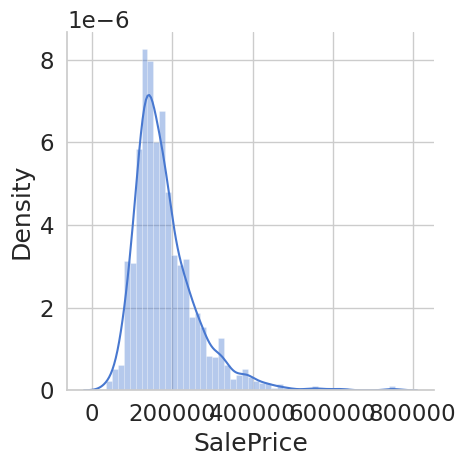

In [4]:
sns.displot(df_train['SalePrice'],kde=True,
    stat="density", kde_kws=dict(cut=3),
    alpha=.4, edgecolor=(1, 1, 1, .4))

Below we can see how the Living Room square feets nicely correlates with the House sale price:

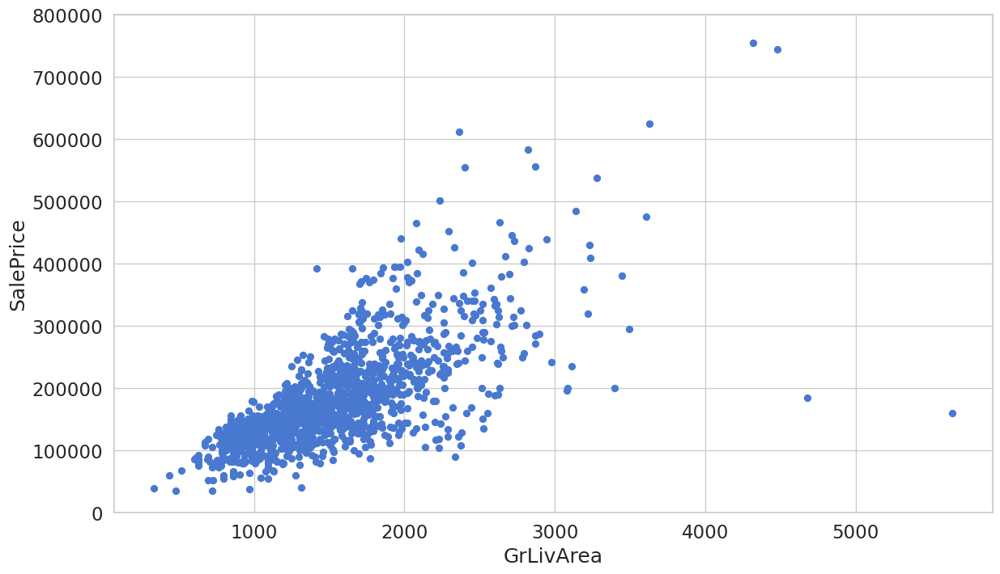

In [14]:
var = 'GrLivArea'
data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000), s=32);

Now, to create a continual learning setting we split the dataset in two: we assume for example that the data comes in two distinct batch, the first one in houses build before 2000 and the second of the more recent houses.

In [15]:
df_new = df_train[df_train.YearBuilt > 2000]
df_old = df_train[df_train.YearBuilt <= 2000]

In [17]:
df_new.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,364.000000,364.000000,332.000000,364.000000,364.000000,364.000000,364.000000,364.000000,357.000000,364.000000,...,364.00000,364.000000,364.000000,364.000000,364.000000,364.000000,364.000000,364.000000,364.000000,364.000000
mean,731.458791,57.541209,73.689759,10025.961538,7.436813,5.008242,2005.049451,2005.425824,160.540616,474.118132,...,116.89011,70.744505,1.054945,2.848901,8.695055,1.318681,5.494505,6.392857,2007.717033,244527.458791
std,426.625746,42.608616,26.845257,5432.267487,1.054371,0.203111,2.061793,2.084309,200.058227,607.753248,...,104.04446,62.883364,12.983662,24.751364,40.255217,25.158836,104.828484,2.839519,1.319335,84534.255772
min,1.000000,20.000000,24.000000,2268.000000,4.000000,2.000000,2001.000000,2001.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,84500.000000
25%,347.750000,20.000000,61.750000,7783.750000,7.000000,5.000000,2004.000000,2004.000000,0.000000,0.000000,...,0.00000,31.500000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2007.000000,185375.000000
50%,735.000000,60.000000,72.000000,9601.500000,7.000000,5.000000,2005.000000,2006.000000,100.000000,42.000000,...,132.00000,51.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,224700.000000
75%,1084.250000,60.000000,85.000000,12088.500000,8.000000,5.000000,2006.250000,2007.000000,245.000000,922.750000,...,179.25000,100.500000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,280250.000000
max,1455.000000,180.000000,313.000000,63887.000000,10.000000,6.000000,2010.000000,2010.000000,1031.000000,5644.000000,...,519.00000,406.000000,177.000000,304.000000,266.000000,480.000000,2000.000000,12.000000,2010.000000,611657.000000


In [18]:
df_old.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1096.000000,1096.000000,869.000000,1096.000000,1096.000000,1096.000000,1096.000000,1096.000000,1095.000000,1096.000000,...,1096.00000,1096.000000,1096.000000,1096.000000,1096.000000,1096.000000,1096.000000,1096.000000,1096.00000,1096.000000
mean,730.181569,56.683394,68.659379,10679.853102,5.655109,5.763686,1960.048358,1978.037409,85.148858,433.517336,...,86.72354,38.661496,28.895073,3.595803,17.175182,3.237226,56.107664,6.298358,2007.84854,159796.488139
std,420.126792,42.215139,23.097648,11083.948206,1.178046,1.222242,26.621350,19.475437,170.472102,392.834904,...,130.82942,65.432383,68.760633,30.691899,59.893241,44.046139,568.926275,2.657880,1.32997,65180.813814
min,2.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.00000,34900.000000
25%,369.750000,20.000000,57.000000,7500.000000,5.000000,5.000000,1944.250000,1960.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.00000,121575.000000
50%,729.500000,50.000000,68.000000,9400.000000,6.000000,5.000000,1963.000000,1977.000000,0.000000,399.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.00000,145000.000000
75%,1099.250000,70.000000,80.000000,11349.000000,6.000000,7.000000,1977.000000,1997.000000,116.000000,681.250000,...,164.00000,57.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.00000,180625.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2000.000000,2010.000000,1600.000000,2096.000000,...,857.00000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.00000,755000.000000


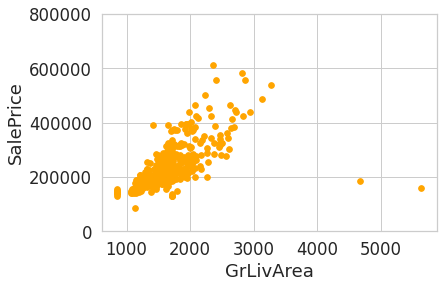

In [ ]:
var = 'GrLivArea'
data = pd.concat([df_train['SalePrice'], df_new[var]], axis=1)
data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000), s=32, color="orange");

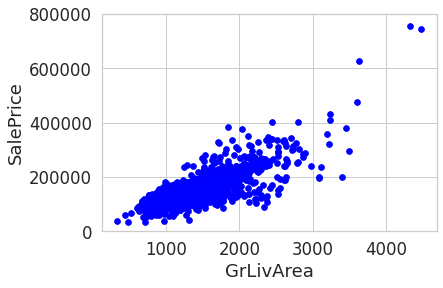

In [ ]:
var = 'GrLivArea'
data = pd.concat([df_train['SalePrice'], df_old[var]], axis=1)
data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000), s=32, color="blue");

It makes sense that on average more recent house are sold at higher prices.
Let us know train the linear regression model our single neuron on the entire training set to get the best params:

In [ ]:
cumul_x = df_train['GrLivArea']
cumul_y = df_train['SalePrice']

# x = (x - x.mean()) / x.std()
cumul_x = np.c_[np.ones(cumul_x.shape[0]), cumul_x] 

cumul_x.shape

(1460, 2)

In [ ]:
def loss(h, y):
  sq_error = (h - y)**2
  n = len(y)
  return 1.0 / (2*n) * sq_error.sum()

In [ ]:
class LinearRegression:

  def __init__(self):
    
    self._W = np.zeros(2)
    self._cost_history = []
    self._w_history = [self._W]
  
  def predict(self, X):

    return np.dot(X, self._W)
  
  def _gradient_descent_step(self, X, targets, lr):

    predictions = self.predict(X)
    
    error = predictions - targets
    gradient = np.dot(X.T,  error) / len(X)

    self._W -= lr * gradient
      
  def fit(self, X, y, n_iter=100000, lr=0.01):

    for i in range(n_iter):
      
        prediction = self.predict(X)
        cost = loss(prediction, y)
        
        self._cost_history.append(cost)
        
        self._gradient_descent_step(X, y, lr)
        
        self._w_history.append(self._W.copy())
        
    return self
      
        

In [ ]:
cumul_clf = LinearRegression()
cumul_clf.fit(cumul_x, cumul_y, n_iter=150, lr=1e-7)

cumul_clf._W

array([9.94290254e-02, 1.18069042e+02])

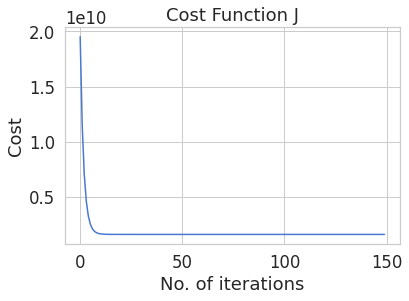

In [ ]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(cumul_clf._cost_history)
plt.show()

In [ ]:
#Animation
def animate(clf, set_x, set_y, frames=150):
    #Set the plot up,
    fig = plt.figure()
    ax = plt.axes()
    plt.title('Sale Price vs Living Area')
    plt.xlabel('Living Area in square feet')
    plt.ylabel('Sale Price ($)')
    if len(set_x) == 1:
        plt.scatter(set_x[0][:,1], set_y[0])
    else:
        plt.scatter(set_x[0][:,1], set_y[0], color="blue")
        plt.scatter(set_x[1][:,1], set_y[1], color="orange")
    line, = ax.plot([], [], lw=2, color='red')
    annotation = ax.text(200, 700000, '')
    # optimal
    x = np.linspace(0, 7000, 1000)
    y = cumul_clf._W[1]*x + cumul_clf._W[0]
    ax.plot(x, y, 'g--')
    annotation.set_animated(True)
    plt.close()

    #Generate the animation data,
    def init():
        line.set_data([], [])
        annotation.set_text('')
        return line, annotation

    # animation function.  This is called sequentially
    def animate(i):
        # x = np.linspace(-5, 20, 1000)
        x = np.linspace(0, 7000, 1000)
        y = clf._w_history[i][1]*x + clf._w_history[i][0]
        line.set_data(x, y)
        annotation.set_text(
            'Cost = %.2f e10\nWeight: %.2f\nBias: %.2f' % 
            (clf._cost_history[i]/1e10, clf._w_history[i][1],
             clf._w_history[i][0]))
        return line, annotation

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                frames=frames, interval=10, blit=True)

    rc('animation', html='jshtml')

    return anim

In [ ]:
anim = animate(cumul_clf, [cumul_x], [cumul_y])
anim

Ok so the best parameters for the job are weight: 9.94290254e-02 and bias:1.18069042e+02. This will appear as a green dashed line in the plot. Let's now move the continual learning scenario.

In this case we will start with the first batch of data (that is the batch with all the old houses data) and than, with the optimal parameters computed at this step we will try to model also the data of the second batch (with the newest houses data).



In [ ]:
x_old = df_old['GrLivArea']
y_old = df_old['SalePrice']

x_old = np.c_[np.ones(x_old.shape[0]), x_old] 

x_old.shape

(1096, 2)

In [ ]:
x_new = df_new['GrLivArea']
y_new = df_new['SalePrice']

x_new = np.c_[np.ones(x_new.shape[0]), x_new] 

x_new.shape

(364, 2)

In [ ]:
cl_clf = LinearRegression()
cl_clf.fit(x_old, y_old, n_iter=150, lr=1e-7)

cl_clf._W

array([1.03397202e-01, 1.08036794e+02])

In [ ]:
anim = animate(cl_clf, [x_old, x_new], [y_old, y_new])
anim

In the plot above we can see that the model is only fitting the old houses data as we would expect! Let us know see what happens if we finetune the model on the newest houses batch!

In [ ]:
# cl_clf = LinearRegression()
cl_clf.fit(x_new, y_new, n_iter=150, lr=1e-7)

cl_clf._W

array([  0.19619107, 141.32530075])

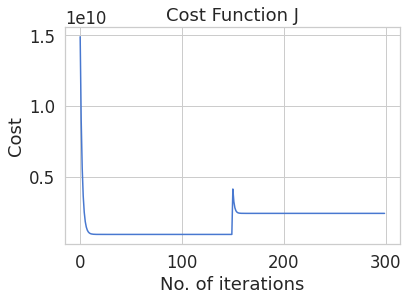

In [ ]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(cl_clf._cost_history)
plt.show()

In [ ]:
anim = animate(cl_clf, [x_old, x_new], [y_old, y_new], frames=300)
anim

So what we can see from the plot above is that even though we are starting from the best possible solution of the previous step our weight and bias parameters are somehow overwritten only to suit the new data distibution of the newest houses. 

Here, we are essetially "*forgetting*" how to correctly predict the price of houses build before 2000 just to better predict the price of the houses built after 2000, even though (here's the point) a better and general parametrization **do exist** and would have reduced the total prediction error.

How can we efficiently learn that best parametrization over time and without accessing previously encontered data is one of the main focus of Continual Learning.